# CIS 5450 Final Project

Group 29: Karen Li, Quinn Liu, Sanya Shetty

UFO Sightings Around The World

# Part 1: Introduction

Our final project aims to uncover the mysteries surrounding Unidentified Flying Objects (UFOs) by analyzing various aspects of UFO sightings reported over the years. We wanted to gain a deeper understanding of the patterns, timings, and locations of these UFO sightings, as well as explore any underlying factors that could predict their occurrence.

To achieve this, we used a comprehensive dataset, `ufo_df`, which documented detailled records of UFO sightings around the world, including the date and time of each sighting, geographic coordinates (latitude and longitude), the shape of the observed UFO, the duration of the encounter, and descriptive accounts of the sightings. As most of the UFO sightings in this dataset were in the United States, we decided to filter our dataset to only include sightings in the U.S.

Throughout the notebook, we present a series of visualizations and findings that provide some insight into understanding the dynamics of UFO sightings. We hope that our analysis sheds light on this intriguing and mysterious subject and provides a data-driven perspective on UFO sightings.

# Part 2: Data Loading & Preprocessing

In Part 2, we import all the necessary packages and load our UFO Sightings dataset from Kaggle. We then summarize and analyze our data at a high level, which informs the cleaning and preprocessing of our data.

In [ ]:
# import packages
import json
import glob
import pandas as pd
import numpy as np

import nltk
from nltk.corpus import stopwords
from nltk.sentiment import SentimentIntensityAnalyzer

import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ParameterGrid

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor

from sklearn.metrics import confusion_matrix
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings("ignore")

## 2.1: Data Loading

We load the UFO Sightings Around The World (Better) dataset from Kaggle, which consists of 80,000+ documented close encounters from the past 70 years, with information related to time, location, and description. We also use a supplementary dataset from Kaggle detailing US state populations in 2018.

The primary dataset can be found here: https://www.kaggle.com/datasets/jonwright13/ufo-sightings-around-the-world-better

In [ ]:
%%capture
!apt update
!pip install kaggle
!pip install folium

In [ ]:
# load data from Kaggle (mount in Google Drive, similar to Homework 4)
from google.colab import drive
drive.mount('/content/drive')

!mkdir ~/.kaggle
!cp /content/drive/MyDrive/kaggle.json ~/.kaggle/

!!kaggle datasets download -d jonwright13/ufo-sightings-around-the-world-better
!unzip /content/ufo-sightings-around-the-world-better.zip

Mounted at /content/drive
Archive:  /content/ufo-sightings-around-the-world-better.zip
  inflating: ufo-sightings-transformed.csv  


In [ ]:
# load additional dataset: US state populations in 2018 from Kaggle
!!kaggle datasets download -d lucasvictor/us-state-populations-2018
!unzip /content/us-state-populations-2018.zip
state_populations_df = pd.read_csv("State Populations.csv")
state_populations_df.head(5)

Archive:  /content/us-state-populations-2018.zip
  inflating: State Populations.csv   


,State,2018 Population
0,California,39776830
1,Texas,28704330
2,Florida,21312211
3,New York,19862512
4,Pennsylvania,12823989


## 2.2: Analyzing Data Structure

We look at the general format of the dataframe, including the columns and their datatypes, as well as some overall statistics about the values within each numerical column.

In [ ]:
# preview UFO dataframe format
ufo_df = pd.read_csv("ufo-sightings-transformed.csv")
ufo_df = ufo_df.drop('Unnamed: 0', axis=1)
ufo_df.head(1)

,Date_time,date_documented,Year,Month,Hour,Season,Country_Code,Country,Region,Locale,latitude,longitude,UFO_shape,length_of_encounter_seconds,Encounter_Duration,Description
0,1949-10-10 20:30:00,4/27/2004,1949,10,20,Autumn,USA,United States,Texas,San Marcos,29.883056,-97.941111,Cylinder,2700.0,45 minutes,This event took place in early fall around 194...


In [ ]:
# get high level stats of each numeric column
ufo_df.describe().round(2)

,Year,Month,Hour,latitude,longitude,length_of_encounter_seconds
count,80328.00,80328.00,80328.00,80328.00,80328.00,80328.00
mean,2003.85,6.84,15.53,38.12,-86.77,9017.34
std,10.43,3.23,7.75,10.47,39.70,620232.23
min,1906.00,1.00,0.00,-82.86,-176.66,0.00
25%,2001.00,4.00,10.00,34.13,-112.07,30.00
50%,2006.00,7.00,19.00,39.41,-87.90,180.00
75%,2011.00,9.00,21.00,42.79,-78.76,600.00
max,2014.00,12.00,23.00,72.70,178.44,97836000.00


In [ ]:
# list names and data types of each column in dataframe
ufo_df.dtypes

Date_time                       object
date_documented                 object
Year                             int64
Month                            int64
Hour                             int64
Season                          object
Country_Code                    object
Country                         object
Region                          object
Locale                          object
latitude                       float64
longitude                      float64
UFO_shape                       object
length_of_encounter_seconds    float64
Encounter_Duration              object
Description                     object
dtype: object

## 2.3: Data Pre-Processing

Since the majority of the UFO sightings data originate from the United States, we decide to filter for only sightings within the United States. For better analysis, we also dropped null entries and added a new "Decade" column. We also reformatted the datetime column and extracted the Day, in addition to the already provided Year and Month.

In [ ]:
# filter UFO sightings in the US
us_ufo_df = ufo_df[ufo_df['Country_Code'] == 'USA']

In [ ]:
# add decade column based on year
us_ufo_df['Decade'] = (us_ufo_df['Year'] // 10) * 10
features = us_ufo_df.drop('Year', axis=1)

In [ ]:
# drop null entries
us_ufo_df_nonull = us_ufo_df.dropna()

In [ ]:
# converting 'Date_time' to correct datetime format
us_ufo_date_time_df = us_ufo_df
us_ufo_date_time_df = us_ufo_df[['Date_time', 'date_documented',	'Year',	'Month',	'Hour',	'Season', 'Region']]
us_ufo_date_time_df = us_ufo_date_time_df.rename(columns = {'Region': 'State'})
us_ufo_date_time_df['Date_time'] = pd.to_datetime(us_ufo_date_time_df['Date_time'])

# extract day from Date_time
us_ufo_date_time_df['Day'] = us_ufo_date_time_df['Date_time'].dt.day

# Part 3: Exploratory Data Analysis


After preprocessing our data and analyzing its structure, we delve deep into the exploratory data analysis of UFO sightings, focusing on three distinct aspects: location, time, and descriptions of the sightings. We chose each of these aspects for our initial analysis because of their potential to reveal unique insights about UFO sightings. This analysis is instrumental in uncovering the underlying patterns and trends in the UFO data, providing us with invaluable insights into the nature and characteristics of these sightings.

## Part 3.1: Location-Based Analysis

We started by performing a location-based analysis, which dispalyed the geographical distribution of UFO sightings. Location is a fundamental aspect in regards to UFO sightings, as it can uncover spatial patterns and hotspots.

Looking at the top 5 states with UFO sightings, California, Florida, Texas, and New York are among the U.S. states with the highest population, so it makes sense that they would also have the greatest number of UFO sightings. States like California, Washington, and Florida are also home to important military bases, which could contribute to their high number of UFO sightings as training/testing exercises could be mistaken by passerbys as UFO activity.

In [ ]:
# filter relevant columns to location: Country, Region, Locale, latitude, longitude
us_ufo_locations_df = us_ufo_df[['Country', 'Region', 'Locale', 'latitude', 'longitude']]
us_ufo_locations_df.head(5)

,Country,Region,Locale,latitude,longitude
0,United States,Texas,San Marcos,29.883056,-97.941111
1,United States,Texas,Bexar County,29.384210,-98.581082
3,United States,Texas,Edna,28.978333,-96.645833
4,United States,Hawaii,Kaneohe,21.418056,-157.803611
5,United States,Tennessee,Bristol,36.595000,-82.188889


In [ ]:
# count number of UFO sightings in each state
us_ufo_states = us_ufo_locations_df['Region'].value_counts().reset_index()
us_ufo_states.columns = ['State', 'Count']

# group territories, districts, etc into 'Other Regions'
other_regions = ['District of Columbia', 'Puerto Rico', 'United States Virgin Islands', 'Guam']
other_regions_sum = us_ufo_states[us_ufo_states['State'].isin(other_regions)]['Count'].sum()
us_ufo_states = us_ufo_states[~us_ufo_states['State'].isin(other_regions)]
us_ufo_states = us_ufo_states.append({'State': 'Other Regions', 'Count': other_regions_sum}, ignore_index=True)

# top 5 states for UFO sightings
us_ufo_states = us_ufo_states.sort_values(by='Count', ascending=False).reset_index(drop=True)
us_ufo_states.head(5)

,State,Count
0,California,9625
1,Washington,4270
2,Florida,4200
3,Texas,3684
4,New York,3235


In [ ]:
# count number of UFO sightings in each city
us_ufo_cities = us_ufo_locations_df[['Locale', 'Region']].value_counts().reset_index()
us_ufo_cities = us_ufo_cities.sort_values(by=0, ascending=False).reset_index(drop=True)
us_ufo_cities['City'] = us_ufo_cities.apply(lambda row: f"{row['Locale']}, {row['Region']}", axis=1)
us_ufo_cities = us_ufo_cities.drop(columns=['Locale', 'Region'])
us_ufo_cities = us_ufo_cities[['City', 0]]
us_ufo_cities.columns = ['City', 'Count']

# top 20 cities for UFO sightings
us_ufo_cities = us_ufo_cities.head(20)
us_ufo_cities

,City,Count
0,"Los Angeles, California",827
1,"New York, New York",656
2,"Seattle, Washington",595
3,"Phoenix, Arizona",504
4,"Las Vegas, Nevada",395
5,"San Diego, California",385
6,"Portland, Oregon",347
7,"Houston, Texas",316
8,"Chicago, Illinois",298
9,"Tucson, Arizona",248


Looking at the top cities for UFO sightings, major urban centers like Los Angeles, New York City, and Seattle being at the top of the list suggest a link between population density and the number of reported sightings. Additionally, cities like Las Vegas and Orlando are known as major tourist destinations. Recreational activities at these tourist destinations, i.e. fireworks at nighttime, could easily be mistaken for UFOs and increase the chances of observing and reporting unusual activity.

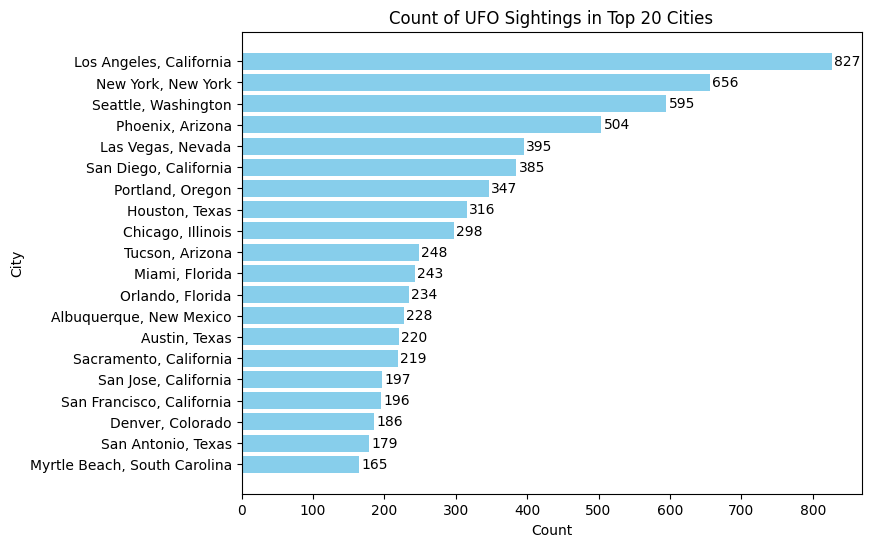

In [ ]:
# plot top 20 cities for UFO sightings
plt.figure(figsize=(8, 6))
us_ufo_cities = us_ufo_cities.sort_values(by='Count', ascending=True)
bars = plt.barh(us_ufo_cities['City'], us_ufo_cities['Count'], color='skyblue')
plt.xlabel('Count')
plt.ylabel('City')
plt.title('Count of UFO Sightings in Top 20 Cities')

# display counts on chart
for bar, count in zip(bars, us_ufo_cities['Count']):
    plt.text(bar.get_width() + 3, bar.get_y() + bar.get_height()/2, str(count), ha='left', va='center')
plt.show()

Looking at the top states with UFO sightings normalized by state population, Washington, Vermont, Montana, Alaska, and Maine all include rural areas with clear skies and significantly less light pollution, which would make it easier to notice unusual objects in the sky. Alaska specifically is known for frequent auroral activity with the Northern Lights, which would lead to increased sky watching and thus likely increased unusual activity reporting.

In [ ]:
# count proportion of UFO sightings normalized by state population (2018)
us_ufo_states_df = pd.merge(us_ufo_states, state_populations_df, on='State')
us_ufo_states_df['Normalized Count'] = us_ufo_states_df['Count'] / us_ufo_states_df['2018 Population']
us_ufo_states_df = us_ufo_states_df[['State', 'Normalized Count']]
us_ufo_states_df = us_ufo_states_df.sort_values(by='Normalized Count', ascending=False).reset_index(drop=True)
us_ufo_states_df.head(5)

,State,Normalized Count
0,Washington,0.000567
1,Vermont,0.000490
2,Montana,0.000481
3,Alaska,0.000478
4,Maine,0.000470


Below, we present a comprehensive visualization of UFO sightings across the United States, with an emphasis on the decade of the 2010s to provide a relevant and manageable timeframe for analysis. This map-based analysis is designed to provide a clear and interactive representation of where and when these sightings have occurred, offering insights into geographical patterns and temporal trends. Our map focuses on the continental U.S. since it has the majority of sightings in our dataset, but feel free to zoom out to view datapoints in Hawaii and Alaska as well. Our interactive map also allows you to click on individual red dots to see the year of that particular sighting.

A notable observation is the distribution of sightings across different regions. There appears to be a higher concentration of sightings along the coasts, which could be related to higher concentration of flight paths both for military testing and travel aircrafts. In contrast, the mid-western region shows a relative gap or lower density of reported sightings. These differences could also be attributed to media influence, as coastal regions with major urban centers may have greater exposure to media and are more open with discussions of UFOs, leading to a higher likelihood of reporting incidents.

In [ ]:
# map of UFO sightings across US in the 2010s
f = folium.Figure(width=800, height=500)
m = folium.Map(width=800, height=500, location=[37.0902, -95.7129], zoom_start=4).add_to(f)

us_ufo_df_2010 = us_ufo_df[us_ufo_df['Year'] >= 2010]
us_ufo_df_2010.apply(lambda row: folium.Circle(
   radius=5,
   location=[row['latitude'], row['longitude']],
   color='crimson',
   fill=True,
   fill_opacity=0.3,
   popup=f"Year: {int(row['Year'])}"
).add_to(m), axis = 1)

m

This segment of our analysis provides a heat map visualization representing UFO encounter durations across the United States. This approach allows us to both pinpoint the locations of sightings and to gauge the length of these encounters, providing deeper insight into the nature of UFO sightings.

The heat map is based on the length of each UFO encounter, measured in seconds. Longer encounters are representing by the intense, warm, red tones on the map, while shorter encounters are represented by the cooler, blue tones.

Due to the vast amount of data and for better clarity in visualization, we chose to use a random sample of the dataset for our heatmap. This sampling ensures a more manageable and representative subset of data, allowing for a clearer and more accurate portrayal of sighting durations.

Similar to the previous analysis of sighting locations, this heat map also highlights the main hotspots for UFO sightings, which is the coastal United States. The regions which had the most UFO encounters in the previous map are also the regions with the longest encounter durations.

In [ ]:
# map of UFO sightings across US (all times sampled)

# define map intensity based on length of encounter in seconds
def map_intensity(length_of_encounter_seconds):
   if length_of_encounter_seconds < 30:
       return 0.05
   elif length_of_encounter_seconds < 180:
       return 0.1
   elif length_of_encounter_seconds < 600:
       return 0.2
   else:
       return 0.4

# create and plot heatmap
ufo_heatmap_df = us_ufo_df[['length_of_encounter_seconds', 'latitude', 'longitude']]
ufo_heatmap_df = ufo_heatmap_df.dropna()
ufo_heatmap_df['intensity'] = ufo_heatmap_df["length_of_encounter_seconds"].apply(lambda x: map_intensity(x))

ufo_heatmap_sampled_df = ufo_heatmap_df.sample(frac=0.01)
ufo_data = ufo_heatmap_sampled_df[['latitude', 'longitude', 'intensity']].values.tolist()

m = folium.Map(width=800, height=500, location=[37.0902, -95.7129], zoom_start=4)

HeatMap(ufo_data).add_to(m)

m

## Part 3.2: Time-Based Analysis

In this section, our analysis shifts focus to the temporal dynamics of UFO sightings, exploring how these incidents have varied over time. Through a series of graphs and tables, we offer a comprehensive view of the temporal trends in UFO sightings across the United States. Looking at a time-based analysis of UFO sightings can help us understand how societal and technological factors could have influenced the frequency of UFO sightings.

In [ ]:
# get number of instances per year
yearly_counts = us_ufo_df['Year'].value_counts().sort_index()

We start with a graph that plots the total number of UFO sightings since 1910 over time. This visualization provides a clear picture of the overall trend in reported sightings, indicating periods of increased or decreased activity.

There are a couple of major observations we can see in the graph below.

Firstly, UFO sightings seem to be fairly low up until the 1990s, where they start to pick up. This could be explained by significant technological and industrial advancements in the 20th century, especially in aviation and space exploration. The development of aircraft, rockets, and later, satellites, could have contributed to increased sightings, as people may have observed and reported aircraft or other aerial phenomena they couldn't identify. The 1900s also saw the rise of mass media, including cinema, television, and the internet. UFOs and extraterrestrial life being portrayed in mass media likely heightened public awareness and interest in UFOs, leading to more reports.


There also seems to be a spike in UFO sightings in 2010. By 2010, the internet had become widely accessible, and the use of smartphones was also much more common. This technological shift likely made reporting sightings easier and more immediate, potentially contributing to the spike in reported sightings, and further perpetuated the interest in UFOs through popular culture and media. The early 2010s also included the development of commercially available drones and continued development of advanced military aircraft. Unidentified sightings during this period could include misidentified drones or new types of aircraft.

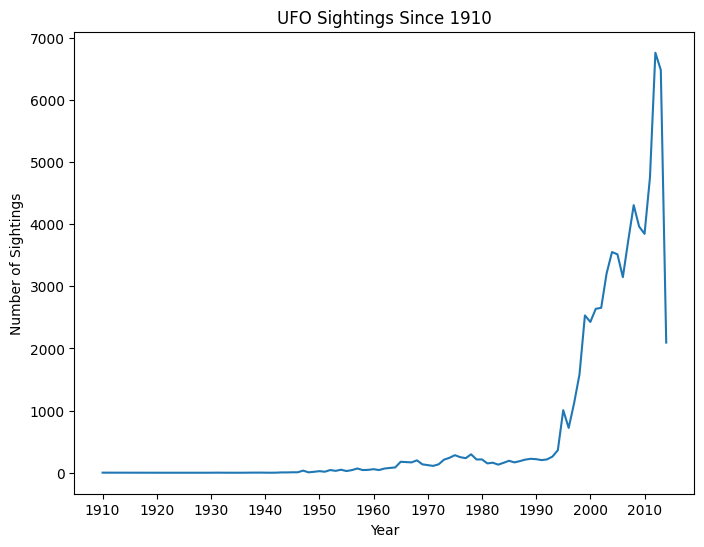

In [ ]:
# plot number of sightings over time

plt.figure(figsize=(8, 6))
plt.plot(yearly_counts.index, yearly_counts.values, linestyle='-')
plt.xlabel('Year')
plt.ylabel('Number of Sightings')
plt.title('UFO Sightings Since 1910')
plt.xticks(range(yearly_counts.index.min(), yearly_counts.index.max()+1, 10))
plt.show()

In [ ]:
# get the number of sightings per state

state_yearly_counts = us_ufo_states.groupby(by = 'State')
state_yearly_counts = state_yearly_counts.head()
t10_state_yearly_counts = state_yearly_counts.nlargest(10, 'Count')
t10_state_list = t10_state_yearly_counts['State'].to_list()

# filter us_ufo_date_time_df by top 10 states

t10_us_ufo_date_time_df = us_ufo_date_time_df[us_ufo_date_time_df['State'].isin(t10_state_list)]
t10_us_ufo_years_df = t10_us_ufo_date_time_df.drop(columns = ['Date_time', 'date_documented', 'Month', 'Hour', 'Season'])
t10_us_ufo_years_df.reset_index(drop = True, inplace = True)

t10_us_ufo_years_df = t10_us_ufo_years_df.groupby(['Year', 'State']).size().unstack(fill_value=0)
t10_us_ufo_years_df

State,Arizona,California,Florida,Illinois,Michigan,New York,Ohio,Pennsylvania,Texas,Washington
Year,,,,,,,,,,
1910,0,0,0,0,0,0,0,0,1,0
1925,0,0,0,1,0,0,0,0,0,0
1930,0,0,0,0,0,1,0,0,0,0
1933,0,0,0,0,0,1,0,0,0,0
1937,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
2010,110,543,204,189,115,167,118,153,207,252
2011,150,575,311,206,142,235,145,176,235,275
2012,194,674,412,254,218,355,252,283,232,390


The plot below shows the UFO sightings per state since 1949 for the top 10 states with UFO sightings. One observation in this graph is that the states seemed to have similar numbers up until around 2000, where California had a sharp increase. California experienced significant population growth and urbanization, especially in technology hubs like Silicon Valley and major cities like Los Angeles, which could lead to more potential observers and thus a higher number of reported sightings. Other factors like media influence and technological advancements could have also contributed to this shift.

Another observation is that Texas had its peak number of sightings in the mid 2000s, which was a few years earlier than the rest of the states on the graph. Texas, which hosts several large military bases, may have experienced increased military activity or testing during this period, leading to more sightings. The mid-2000s were a time of heightened military engagement globally, which could be reflected in domestic military movements or tests.

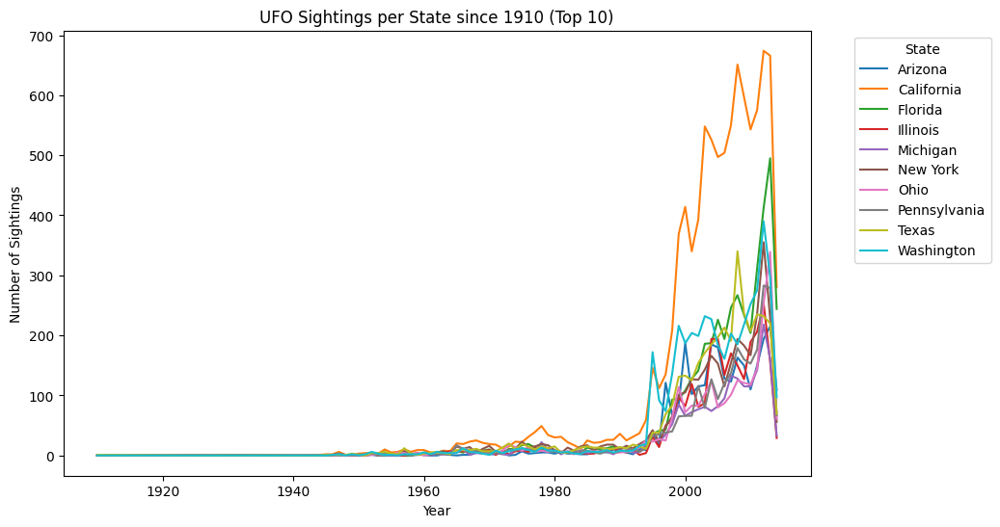

In [ ]:
# plot each top 10 states' sightings over time

t10_us_ufo_years_df.plot(kind = 'line', linestyle = '-', figsize = (10, 6))
plt.xlabel('Year')
plt.ylabel('Number of Sightings')
plt.title('UFO Sightings per State since 1910 (Top 10)')
plt.legend(title = 'State', bbox_to_anchor = (1.05, 1), loc = 'upper left')
plt.show()

Now, we normalized sightings by population and created a graph that shows the top 10 states' sightings over time based on the number of sightings per person. This plot was insightful and had a couple of surprising takeaways.

Firstly, Washington and Arizona now seemed to be leading in sightings per person. Washington's lead in sightings per capita could be attributed to its unique environmental conditions, including vast, clear skies which are popular for skywatching. Additionally, a strong cultural interest in aerospace and extraterrestrial phenomena, partly due to the presence of major aerospace companies in the Washington area, could contribute to a higher per capita rate of sightings. Arizona is also known for its clear skies and dark conditions, which are known for observing celestial activity and phenomena. The state also has numerous astronomical observatories, which could indicate a generally higher public interest in sky observation, similar to Washington, and thus leading to more frequent reporting of unusual sightings per capita. Its also interesting that the graphs for both of these states have generally similar shapes, but with varying amplitudes, which could be due media coverage and the portrayal of UFOs in popular culture.

California is also not dominating the normalized graph and generally blends in with the majority of the other top states, indicating that its high absolute number of sightings is partly due to its large population. This suggests that the likelihood of an individual reporting a UFO sighting in California is less compared to states like Washington and Arizona when adjusted for population size.

Overall, the normalized analysis offers a different perspective compared to absolute sighting numbers. It highlights the importance of considering population size when evaluating UFO sighting reports. The trends observed suggest that states like Washington and Arizona, with favorable conditions for skywatching and strong interests in such activities, have higher sightings per person. The variations over time and between states highlight the complex interplay of environmental conditions, cultural factors, and population dynamics in shaping UFO sighting reports.

In [ ]:
# normalize sightings by population
t10_state_populations_df = state_populations_df[state_populations_df['State'].isin(t10_state_list)]
t10_us_ufo_years_normalized_df = t10_us_ufo_years_df

for state in t10_us_ufo_years_df.columns:
    if state in t10_state_populations_df['State'].tolist():
        t10_us_ufo_years_normalized_df[state] = t10_us_ufo_years_df[state] / t10_state_populations_df.loc[t10_state_populations_df['State'] == state, '2018 Population'].values[0]

t10_us_ufo_years_normalized_df.head(3)

State,Arizona,California,Florida,Illinois,Michigan,New York,Ohio,Pennsylvania,Texas,Washington
Year,,,,,,,,,,
1910,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,3.483795e-08,0.0
1925,0.0,0.0,0.0,7.831884e-08,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
1930,0.0,0.0,0.0,0.000000e+00,0.0,5.034610e-08,0.0,0.0,0.000000e+00,0.0


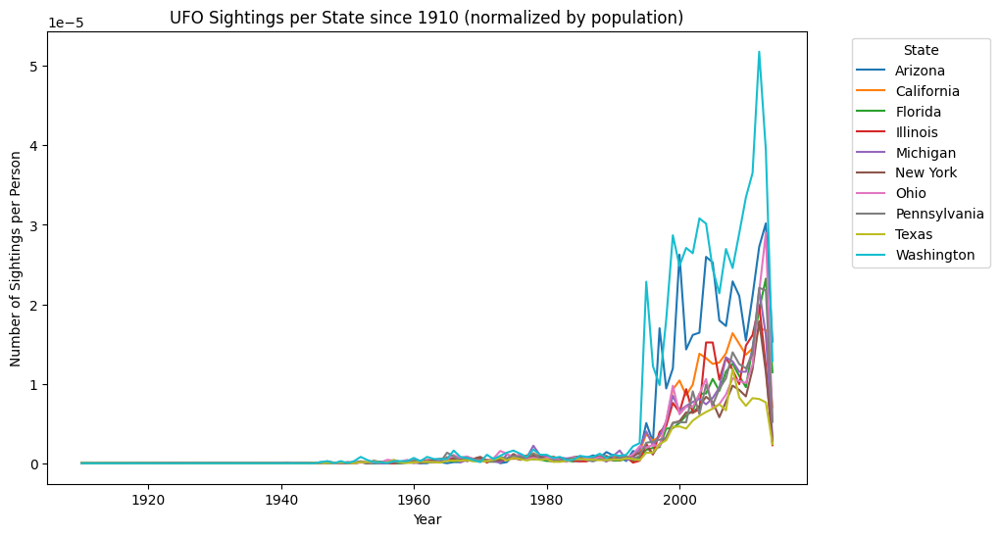

In [ ]:
# top 10 states' sightings over time based on number of sightings per person
t10_us_ufo_years_df.plot(kind = 'line', linestyle = '-', figsize = (10, 6))
plt.xlabel('Year')
plt.ylabel('Number of Sightings per Person')
plt.title('UFO Sightings per State since 1910 (normalized by population)')
plt.legend(title = 'State', bbox_to_anchor = (1.05, 1), loc = 'upper left')
plt.show()

Finally, to finish off our time-based analysis, we created plots of the number of sights per month for each year from 1943 to 2014. There were several intriguing insights from this visualization.

Firstly, most years had graphs with very similar shapes, which included a huge spike in the middle of the year in June or July. The consistent spikes in sightings during the middle of the year can be attributed to several factors. In many parts of the U.S., summer months have clearer skies and longer days, making it more conducive for sky watching and would make it easier to notice unusual aerial phenomena. People are more likely to go outdoors during the warmer months, increasing the chances of observing and reporting UFOs. However, one of the most likely reasons for this spike is that the summer months, specifically July, have a lot of celebrations with fireworks (i.e. 4th of July). A lot of sightings could be due to civilians mistaking fireworks for UFO activity.

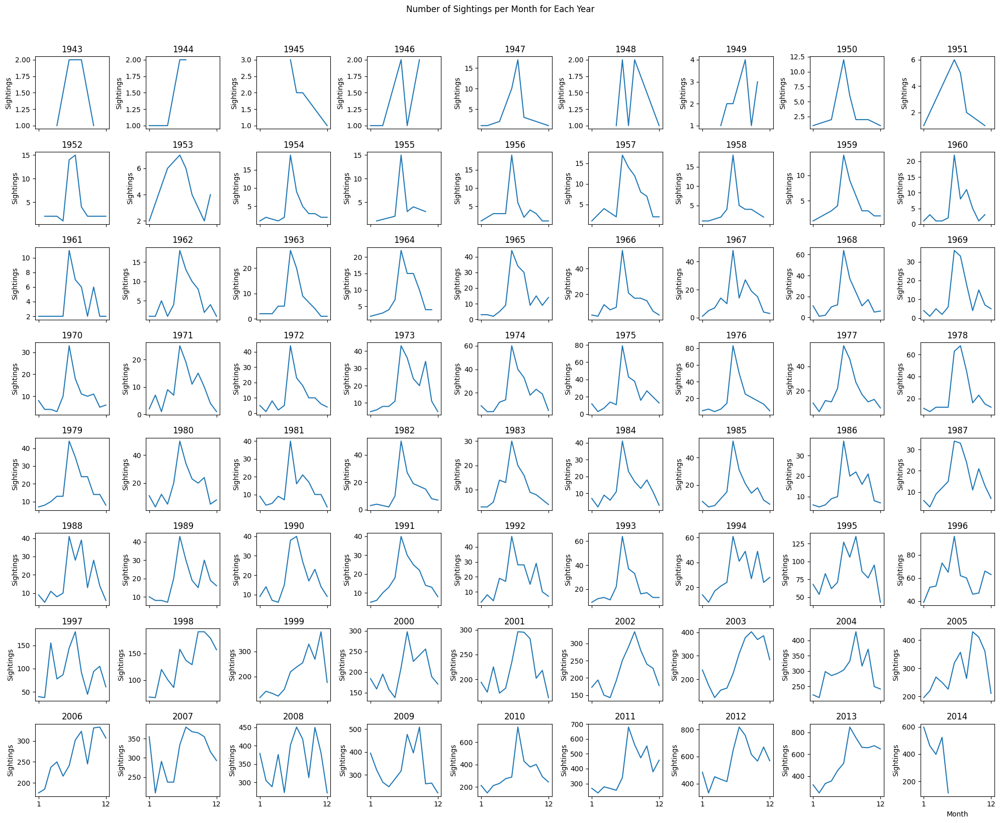

In [ ]:
## plotting by month, for each year

us_ufo_date_time_df

sightings_per_month_per_year_df = us_ufo_date_time_df.groupby(['Year', 'Month']).size().reset_index(name='Num Sightings')
unique_years = sightings_per_month_per_year_df['Year'].unique()
unique_years = [x for x in unique_years if x >= 1943]
unique_years
num_years = len(unique_years)

num_rows = int(num_years**0.5)
num_cols = int((num_years + num_rows - 1) / num_rows)

fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 2 * num_rows), sharex=True, gridspec_kw={'width_ratios': [1] * num_cols})

for i, year in enumerate(unique_years):
    row, col = divmod(i, num_cols)  # Calculate the row and column index for the subplot
    data_for_year = sightings_per_month_per_year_df[sightings_per_month_per_year_df['Year'] == year]

    # Plotting in each subplot
    axes[row, col].plot(data_for_year['Month'], data_for_year['Num Sightings'], label=str(year))
    axes[row, col].set_title(f'{year}')
    axes[row, col].set_ylabel('Sightings')

# Set common labels
plt.xlabel('Month')
plt.xticks([1, 12])
plt.suptitle('Number of Sightings per Month for Each Year', y=1.02)
plt.tight_layout()
plt.show()

## Part 3.3: Description-Based Analysis

In this segment of our analysis, we delve into the descriptive elements of UFO sightings, utilizing natural language processing (NLP) techniques using the Natural Language Toolkit (NLTK) to extract insights from the descriptions of sightings. This part of our study comprises three key components: a word cloud visualization, sentiment analysis of UFO descriptions, and a box plot analysis of sentiment scores across different UFO shapes.



In [ ]:
nltk.download('stopwords')
nltk.download('punkt')
stopwords = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
# tokenized_content function
def tokenized_content(content):
  tokens = nltk.word_tokenize(content)
  tokens_filtered = [token.lower() for token in tokens if token.isalpha() and token.lower() not in stopwords]
  return tokens_filtered

In [ ]:
# tokenize descriptions and find top tokens
us_ufo_descriptions = us_ufo_df_nonull['Description']
top_tokens_list = us_ufo_descriptions.apply(lambda x: tokenized_content(x))
top_tokens = [token for token_list in top_tokens_list for token in token_list]

The word cloud presents a visual aggregation of the most frequently used words in the UFO sighting descriptions, providing an immediate visual understanding of the recurring themes and descriptors in these accounts. Larger words in the cloud indicate higher frequency, pointing to the most common elements or characteristics reported in sightings, such as "bright light" or "sky." Many of the popular words are describing the visual appearance of the UFO sighting (i.e. "red light", "white light", "hovering", etc.), which suggests that visual features are the most striking aspect of a UFO encounter. One of the other popular words is NUFORC, which stands for the National UFO Reporting Center.

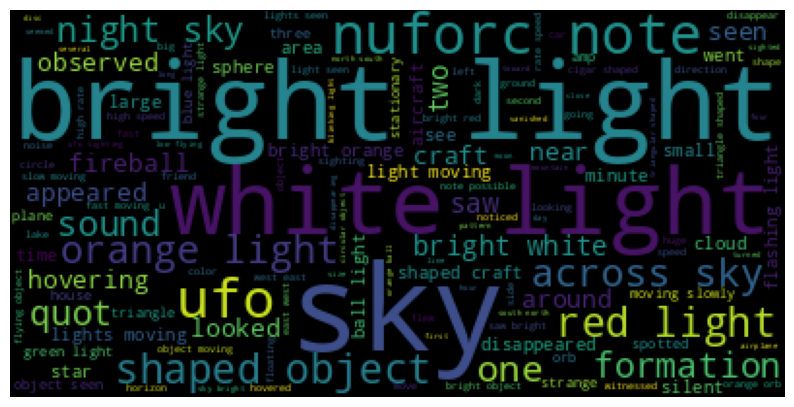

In [ ]:
# make wordcloud of top tokens
from wordcloud import WordCloud
wordcloud = WordCloud().generate(' '.join(top_tokens))
plt.figure(figsize=(10, 10))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

We conducted sentiment analysis on the textual descriptions from the dataset to gauge the emotional tone of each report, using NLTK's VADER Sentiment Analyzer. This analysis categorizes sentiments into positive, negative, or neutral, providing an understanding of the witnesses' emotional responses to their sightings. The sentiment analyzer also provides a compound score, which combines the positive, negative, and neutral scores to give a single metric for the overall sentiment of the text.

In [ ]:
# apply sentiment analysis
nltk.download('vader_lexicon')

sia = SentimentIntensityAnalyzer()
us_ufo_df_nonull['sentiment_score'] = us_ufo_df_nonull['Description'].apply(lambda x: sia.polarity_scores(x))

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


In [ ]:
# extract positive, negative, netural, and compound scores
us_ufo_df_nonull['positive_score'] = us_ufo_df_nonull['sentiment_score'].apply(lambda x: float(x['pos']))
us_ufo_df_nonull['negative_score'] = us_ufo_df_nonull['sentiment_score'].apply(lambda x: float(x['neg']) )
us_ufo_df_nonull['neutral_score'] = us_ufo_df_nonull['sentiment_score'].apply(lambda x: float(x['neu']))
us_ufo_df_nonull['compound_score'] = us_ufo_df_nonull['sentiment_score'].apply(lambda x: float(x['compound']))

In [ ]:
# display sentiment scores
us_ufo_df_nonull = us_ufo_df_nonull.sort_values(by = ['compound_score'], ascending = False).reset_index(drop=True)
us_ufo_df_nonull[['Description', 'positive_score', 'negative_score', 'neutral_score', 'compound_score']].head(3)

,Description,positive_score,negative_score,neutral_score,compound_score
0,ok i didnt see it but i heard about it and was...,0.413,0.0,0.587,0.9411
1,Object looked liked a star but it got so brigh...,0.406,0.0,0.594,0.9365
2,I was visiting friends in Lawton and everyone ...,0.441,0.0,0.559,0.9217


The box plot analysis breaks down the sentiment scores based on the different reported shapes of UFOs, such as "Light", "Fireball", or "Cylinder". The fact that most UFO shapes have positive compound scores suggests that, generally, the descriptions of UFO sightings tend to lean towards a more positive or neutral sentiment. This could indicate that witnesses often describe their experiences with a sense of awe, curiosity, or intrigue, instead of fear or negativity. Overall, the variability in sentiment scores across different shapes suggests that the perceived shape of a UFO can significantly influence the emotional response of the observer.

The "Round" shape is the only one whose box plot dips into negative territory, which is intersting. This could suggest a different perception or experience associated with this particular UFO shape due to their resemblance to more traditional or stereotypical depictions of UFOs.

The "Light" and "Flash" shapes seem to have the highest compound scores, but still do not pass a score of 0.5. These shapes might be associated with natural phenomena that is less intimidating or more familiar, such as bright lights in the sky, leading to more positive descriptions. The fact that these scores do not go over 0.5 could indicate that while the experiences are positive, they are not overwhelmingly so, possibly due to the uncertainty and mystery surrounding these sightings.

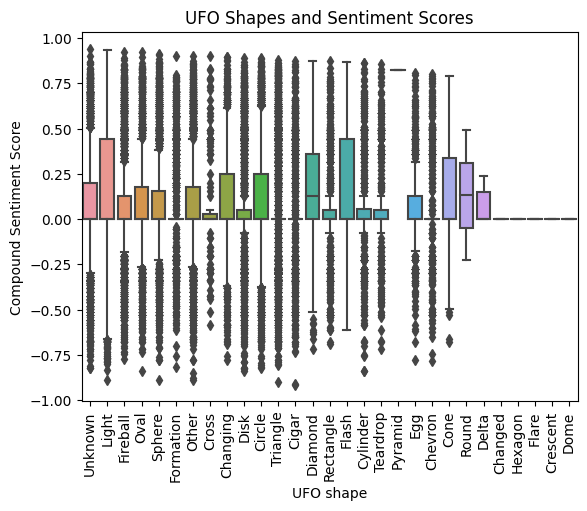

In [ ]:
# box plot of UFO shape and compound score
us_ufo_df_nonull['UFO_shape_encoded'] = us_ufo_df_nonull['UFO_shape'].astype('category').cat.codes

sns.boxplot(x=us_ufo_df_nonull['UFO_shape'], y=us_ufo_df_nonull['compound_score'], data=us_ufo_df_nonull)
plt.xticks(rotation=90)
plt.xlabel('UFO shape')
plt.ylabel('Compound Sentiment Score')
plt.title('UFO Shapes and Sentiment Scores')

plt.show()

# Part 4: Feature Engineering & Preprocessing

After our Exploratory Data Analysis, which yielded insights on patterns in time, location, and description, we preprocess our data for modeling. We encoded categorical data, such as UFO shape, into numerical values in order to create our correlation matrix. While we attempted PCA to reduce dimensionality and better summarize the data, we found that PCA did not improve the accuracy of our models, so opted to ultimately not use it.

In [ ]:
# encode categorical UFO shape as a numerical value
label_encoder = LabelEncoder()

encoded_ufo_df = ufo_df[['Year', 'Month', 'Hour', 'latitude', 'longitude', 'length_of_encounter_seconds', 'UFO_shape']].copy()
encoded_ufo_df['UFO_shape_encoded'] = label_encoder.fit_transform(encoded_ufo_df['UFO_shape'])
encoded_ufo_df = encoded_ufo_df.drop('UFO_shape', axis=1)
encoded_ufo_df.head(3)

,Year,Month,Hour,latitude,longitude,length_of_encounter_seconds,UFO_shape_encoded
0,1949,10,20,29.883056,-97.941111,2700.0,8
1,1949,10,21,29.384210,-98.581082,7200.0,19
2,1955,10,17,53.200000,-2.916667,20.0,4


In [ ]:
# list all recorded UFO shapes
len(label_encoder.classes_), label_encoder.classes_

(30,
 array(['Changed', 'Changing', 'Chevron', 'Cigar', 'Circle', 'Cone',
        'Crescent', 'Cross', 'Cylinder', 'Delta', 'Diamond', 'Disk',
        'Dome', 'Egg', 'Fireball', 'Flare', 'Flash', 'Formation',
        'Hexagon', 'Light', 'Other', 'Oval', 'Pyramid', 'Rectangle',
        'Round', 'Sphere', 'Teardrop', 'Triangle', 'Unknown', nan],
       dtype=object))

We create and visualize a correlation matrix for the numerical features of our data, such as year, month hour, length of encounter in seconds, compound sentiment score, UFO shape, and state, in order to determine the coefficients for different variables. Based on our correlation matrix below, it appears that there is low correlation between most features in our data, with many values being very close to 0.

<Axes: title={'center': 'Correlation Heatmap for Numeric Features of UFO Properties'}>

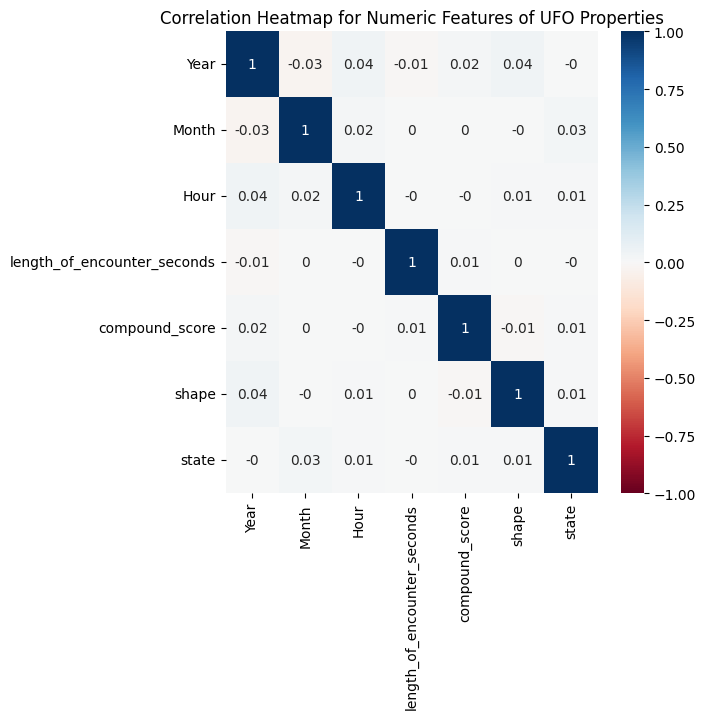

In [ ]:
# encode UFO shape and region (state) as numerical values
label_encoder = LabelEncoder()
label_encoder2 = LabelEncoder()

encoded_ufo_df = us_ufo_df_nonull[['Year', 'Month', 'Hour', 'Region', 'length_of_encounter_seconds', 'compound_score', 'UFO_shape']].copy()
encoded_ufo_df['shape'] = label_encoder.fit_transform(encoded_ufo_df['UFO_shape'])
encoded_ufo_df['state'] = label_encoder2.fit_transform(encoded_ufo_df['Region'])
encoded_ufo_df = encoded_ufo_df.drop('UFO_shape', axis=1)
encoded_ufo_df = encoded_ufo_df.drop('Region', axis=1)
encoded_ufo_df

# make and plot correlation matrix
corr_mat = encoded_ufo_df.corr().round(2)
plt.figure(figsize=(6, 6))
plt.title("Correlation Heatmap for Numeric Features of UFO Properties")
label_encoder = LabelEncoder()

sns.heatmap(corr_mat, cmap='RdBu', center=0, annot=True, vmin=-1, vmax=1)

# Part 5: Modeling

Based on our feature engineering and preprocessing, we create several models for classification and regression. Specifically, we predict UFO shape and number of sightings from date.

## 5.1: Classification (UFO Shape)

Our classification task involves predicting UFO shape based on other features. Our model is motivated by the fact that shape represents an important part of the UFO description, since shape can help us understand and categorize reported sightings. From the above feature preprocessing, we see that there are around 30 total reported shapes, with the most common being “Light”, “Circle”, and “Triangle”. We create a baseline model, then resample our data and conduct a hyperparameter search to improve model accuracy.

### Baseline Model

We create a baseline model that uses all numerical features visualized in the above correlation matrix to predict UFO shape. The baseline model is a Random Forest Classifier using similar hyper parameters to homework, with `classweight=‘balanced’`, `n_estimators=120`, `max_depth=30`.

In [ ]:
# use all features besides shape to predict shape

features = encoded_ufo_df.drop(['shape'], axis=1)

target = encoded_ufo_df['shape']

X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2)

In [ ]:
# use random forest classifier to predict

model = RandomForestClassifier(class_weight='balanced', n_estimators=120, max_depth=30)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rf_acc = model.score(X_test, y_test)

rf_confusion = confusion_matrix(y_test, y_pred)

rf_acc

0.1915678333815447

In [ ]:
# relative frequencies of each class of model
us_ufo_df_nonull['UFO_shape'].value_counts(normalize=True)

Light        0.211479
Triangle     0.102275
Circle       0.095332
Fireball     0.080507
Unknown      0.072118
Other        0.070975
Sphere       0.068661
Disk         0.065623
Oval         0.047645
Formation    0.031358
Cigar        0.025992
Changing     0.025110
Flash        0.016894
Rectangle    0.016749
Cylinder     0.016373
Diamond      0.014724
Chevron      0.012584
Egg          0.009315
Teardrop     0.009257
Cone         0.003876
Cross        0.002936
Delta        0.000087
Round        0.000029
Crescent     0.000029
Pyramid      0.000014
Changed      0.000014
Hexagon      0.000014
Flare        0.000014
Dome         0.000014
Name: UFO_shape, dtype: float64

From the above baseline model, we obtained an accuracy of close to 20%. While this accuracy is definitely higher than random assignment when given 30 classes, a closer analysis reveals that the majority class of “Light” represents around 21% of the total UFO shapes, while other shapes such as "Flare" and "Dome" represent a nearly negligible proportion. Since the accuracy of our model is dominated by the majority class, the model is likely not performing well on minority classes, due to this data imbalance.

## Improved Models

To improve our models, we first resample our data. First, we filter out very uncommon UFO shapes based on the counts of each category, as we found that shapes such as “Round”, “Delta”, and “Pyramid” had less than 2 instances each. We then resample through oversampling smaller classes and undersampling large classes such that the data is evenly distributed with 1000 instances per shape. We use one hot encoding for categorical data such as Region (state) and split the train and test data with an 80-20 split.

In [ ]:
# filter out very uncommon UFO shapes
selected_shapes = ['Round', 'Delta', 'Pyramid']
shape_filter = ~us_ufo_df_nonull['UFO_shape'].isin(selected_shapes)
less_shapes = us_ufo_df_nonull[shape_filter]

# resample such that data is evenly distributed with 500 entries per shape
even_distribution_df = less_shapes.groupby('UFO_shape').apply(lambda group: group.sample(n=500, replace=True))
even_distribution_df.reset_index(drop=True, inplace=True)

# define features
features = even_distribution_df[['Decade', 'Month', 'Hour', 'Region', 'latitude', 'longitude', 'length_of_encounter_seconds', 'compound_score']].copy()

 # one hot encode categorical data (Region)
categorical_columns = features.select_dtypes(include=['object']).columns
features = pd.get_dummies(features, columns=categorical_columns)

# define target
target = even_distribution_df['UFO_shape']

# split train and test data
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2)

We first attempt a Logistic Regression model, using `multi_class=‘ovr’`, which yielded a slightly higher accuracy than `‘multinomial’` and `‘auto’`. We fit the model and predict on the test set to yield an accuracy of around 23%. The below confusion matrix illustrates that the model does well on predicting shapes with low frequency in the original dataset, such as “Changed”, “Crescent”, “Dome”, “Flare”, and “Hexagon”, but overpredicts other classes, as illustrated by the vertical line present at “Chevron”.

Accuracy: 0.22884615384615384


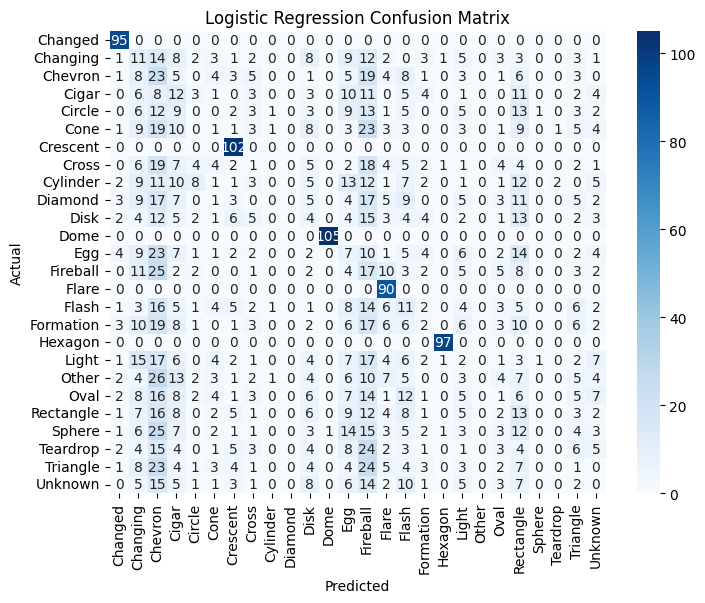

In [ ]:
# initialize logistic regression model and fit to training set
model = LogisticRegression(penalty=None, multi_class='ovr')
model.fit(X_train, y_train)

# predict on test set
y_pred = model.predict(X_test)

# find accuracy
log_acc = model.score(X_test, y_test)
print(f"Accuracy: {log_acc}")

# confusion matrix
rf_confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(rf_confusion, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_ , yticklabels=model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Logistic Regression Confusion Matrix')
plt.show()

We then attempt a Random Forest Classifier, which yields a much higher accuracy of 45%. From the confusion matrix, we see that the majority of entries for each shape are now being predicted correctly.

Accuracy: 0.45346153846153847


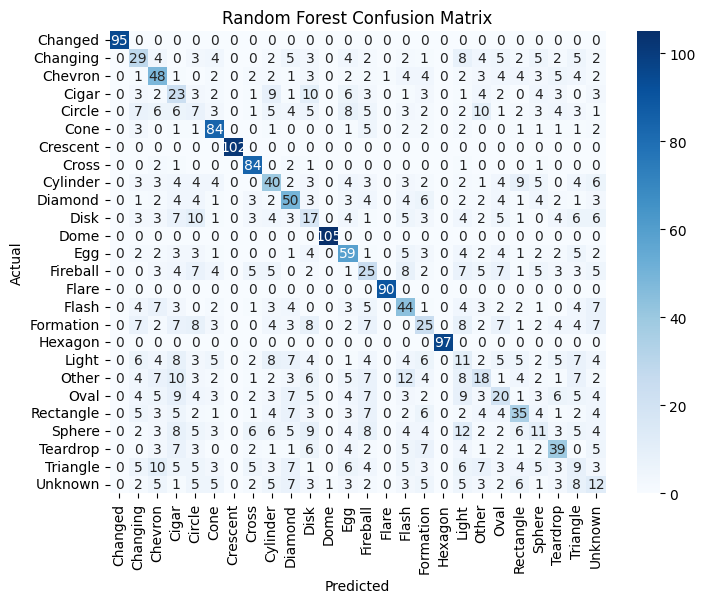

In [ ]:
# initialize random forest model and fit to training set
model = RandomForestClassifier(class_weight='balanced', n_estimators=120, max_depth=30)
model.fit(X_train, y_train)

# predict on test set
y_pred = model.predict(X_test)

#find accuracy
rf_acc = model.score(X_test, y_test)
print(f"Accuracy: {rf_acc}")

# confusion matrix
rf_confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(rf_confusion, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_ , yticklabels=model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Random Forest Confusion Matrix')
plt.show()

We perform hyperparameter tuning on `n_estimators`, `max_depth`, and number of samples per class when resampling in order to improve the accuracy of our model. We found that the number of samples per class is incredibly influencial toward improving the accuracy of the model, with the best parameters of `n_estimators=120`, `max_depth=40`, and `num_samples=2000` yielding an accuracy of 68.6%.

In [ ]:
# create parameter grid
param_grid = {
    'n_estimators' : [60, 120, 180],
    'max_depth' : [20, 30, 40],
    'num_samples' : [500, 1000, 2000],  # number of samples per class when resampling
}

pgrid = ParameterGrid(param_grid)

# track best model accuracy and parameters
best_accuracy = 0
best_params = {}

# conduct grid search
for params in pgrid:
  # resample data
  even_distribution_df = less_shapes.groupby('UFO_shape').apply(lambda group: group.sample(n=params['num_samples'], replace=True))
  even_distribution_df.reset_index(drop=True, inplace=True)
  even_distribution_df['UFO_shape'].value_counts(normalize=True)
  # define features and target
  features = even_distribution_df[['Decade', 'Month', 'Hour', 'Region', 'latitude', 'longitude', 'length_of_encounter_seconds', 'compound_score']].copy()
  categorical_columns = features.select_dtypes(include=['object']).columns
  features = pd.get_dummies(features, columns=categorical_columns)
  target = even_distribution_df['UFO_shape']
  # split train and test data
  X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2)

  # define and train model
  model = RandomForestClassifier(class_weight='balanced', n_estimators=params['n_estimators'], max_depth=params['max_depth'])
  model.fit(X_train, y_train)
  acc = model.score(X_test, y_test)
  print(f"Params: {params}, Accuracy: {acc}")
  if acc > best_accuracy:
    best_accuracy = acc
    best_params = params

best_params

Params: {'max_depth': 20, 'n_estimators': 60, 'num_samples': 500}, Accuracy: 0.45076923076923076
Params: {'max_depth': 20, 'n_estimators': 60, 'num_samples': 1000}, Accuracy: 0.5515384615384615
Params: {'max_depth': 20, 'n_estimators': 60, 'num_samples': 2000}, Accuracy: 0.6652884615384616
Params: {'max_depth': 20, 'n_estimators': 120, 'num_samples': 500}, Accuracy: 0.4653846153846154
Params: {'max_depth': 20, 'n_estimators': 120, 'num_samples': 1000}, Accuracy: 0.5590384615384615
Params: {'max_depth': 20, 'n_estimators': 120, 'num_samples': 2000}, Accuracy: 0.6703846153846154
Params: {'max_depth': 20, 'n_estimators': 180, 'num_samples': 500}, Accuracy: 0.4523076923076923
Params: {'max_depth': 20, 'n_estimators': 180, 'num_samples': 1000}, Accuracy: 0.555
Params: {'max_depth': 20, 'n_estimators': 180, 'num_samples': 2000}, Accuracy: 0.6763461538461538
Params: {'max_depth': 30, 'n_estimators': 60, 'num_samples': 500}, Accuracy: 0.44653846153846155
Params: {'max_depth': 30, 'n_estimators

{'max_depth': 40, 'n_estimators': 120, 'num_samples': 2000}

## 5.2: Regression (Number of Sightings)

Our regression task involves predicting UFO the number of UFO sightings for a given date. Our model is motivated by the fact that UFO sightings are seasonal and very date-dependent, as indicated from the temporal EDA. From the above pre-processing, even though most of the reported sightings occured from the years 2000-2014, the observable pattern of number of sightings over each year remains the same. We first create a basic linear regression model over the data, and then use polynomial feature preprocessing to better capture the non-linear relationship between dates and number of sightings. Additionally, we perform a random forest regression on the data as a different approach to the problem of capturing the non-linear relationship.

In [ ]:
# create new dataframe with isolated 'Year', 'Month', 'Day' columns
us_ufo_date_df = us_ufo_date_time_df.drop(columns = ['Date_time', 'date_documented', 'Hour', 'Season', 'State'])
us_ufo_date_df.reset_index(inplace = True, drop = True)

# group by 'Year', 'Month', 'Day' on the size of 'Num Sightings' to get the number of sightings per date
sightings_per_date_df = us_ufo_date_time_df.groupby(['Year', 'Month', 'Day']).size().reset_index(name='Num Sightings')
X_train, X_test, y_train, y_test = train_test_split(sightings_per_date_df.drop(columns = 'Num Sightings'), sightings_per_date_df['Num Sightings'], test_size = 0.2, random_state = 41)

# create and fit linear regression
reg = LinearRegression()
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)

# evaluate model using R-squared and mean squared error
lin_reg_score_test = reg.score(X_test, y_test)
lin_reg_score_train = reg.score(X_train, y_train)
mse = mean_squared_error(y_test, y_pred)

print('Test Set R^2 value: ' + str(lin_reg_score_test))
print('Training Set R^2 value: ' + str(lin_reg_score_train))
print('Mean Squared Error: ' + str(mse))

Test Set R^2 value: 0.2694890980486466
Training Set R^2 value: 0.23008107543554612
Mean Squared Error: 42.91165812927161


Given the fact we expect there to be a non-linear relationship, we performed polynomial feature pre-processing and with a degree of 4, found the accruacy to be much improved at around 44% with a lower mean squared error of around 33.

In [ ]:
degree = 4
poly = PolynomialFeatures(degree)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

# Fit a linear regression model on the polynomial features
reg = LinearRegression()
reg.fit(X_train_poly, y_train)

# Predict on the test set
y_pred = reg.predict(X_test_poly)

# Evaluate the model using R-squared
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('R^2 value: ' + str(r2))
print('Mean Squared Error: ' + str(mse))

R^2 value: 0.44013376174079466
Mean Squared Error: 32.88765239522766


Similarly, we decided to try a random forest regressor to tackle the non-linearity problem and with the number of estimators at 20, we were able to get an improved accuracy and mean squared error of around 48% and 30, respectively.

In [ ]:
# test different estimators
for n in [5, 10, 20, 50, 100]:
  # Initialize a RandomForestRegressor with a fixed random seed for reproducibility
  rf_regressor = RandomForestRegressor(n_estimators=n, random_state=42)

  # Train the RandomForestRegressor model using the training data
  rf_regressor.fit(X_train, y_train)

  # Use the trained model to make predictions on the test data
  y_pred = rf_regressor.predict(X_test)

  # Calculate the R^2 and mean squared error
  r2 = r2_score(y_test, y_pred)
  mse = mean_squared_error(y_test, y_pred)

  print('Number of Estimators: ' + str(n))
  print('R^2 value: ' + str(r2))
  print('Mean Squared Error: ' + str(mse))
  print()

Number of Estimators: 5
R^2 value: 0.42719313168415507
Mean Squared Error: 33.64781065088758

Number of Estimators: 10
R^2 value: 0.46398719188495985
Mean Squared Error: 31.48645463510848

Number of Estimators: 20
R^2 value: 0.4850252093931018
Mean Squared Error: 30.25063979289941

Number of Estimators: 50
R^2 value: 0.43731516947776206
Mean Squared Error: 33.05322209072978

Number of Estimators: 100
R^2 value: 0.4507883104798991
Mean Squared Error: 32.26178308678501



# Part 6: Conclusion

## 6.1: Key Findings

Through our comprehensive analysis of UFO sightings, we have uncovered several key findings:
* Location-Based Analysis: Based on the geographical distribution of UFO sightings, we found hotspots along the coasts, potentially related to flight paths, military activity, and population density. Rural areas with clear skies, such as Washington and Arizona, also showed higher sightings per capita.
* Time-Based Analysis: Temporal trends indicate a surge in sightings from the 1990s, potentially influenced by technological advancements, media exposure, and the rise of the internet. Seasonal patterns show spikes in sightings during the summer, possibly linked to clearer skies and fireworks during the Fourth of July.
* Description-Based Analysis: We analyzed of UFO descriptions through natural language processing (NLP) techniques to determine whether reports generally had positive or neutral sentiments. Different shapes of UFOs potentially influence sentiment, with "Round" shapes uniquely leaning toward negative, while all other shapes remain neutral or positive.
* Modeling: Our classification models successfully predicted UFO shapes with improved accuracy after addressing data imbalances through resampling and optimizing hyperparameters. The Random Forest Classifier achieved an accuracy of 68.6%. Our regression models attempted predict the number of UFO sightings for a given date. After data processing and using Random Forest Regression, were able to achieve an accuracy of 48.5%.

## 6.2: Description of Challenges / Obstacles Faced

* Low Correlation in Data:

  - Our correlation matrix yielded little insight into what features may be correlated in order to inform our models. Since understanding and predicting UFO sightings involves many factors, this complexity makes it challenging to establish definitive causation or patterns to predict using classification and regression.

  - Before settling on the number of sightings and day/month/year as a target variable and feature set, several other attempts were made. For example, duration of encounter predicted by location had very low correlation, in which we attempted predicting based on both state and latitude/longitude. Duration of encounter predicted by date/time also yieleded similarly poor results due to low correlation.

* Imbalanced Data:

  - The classification task faced challenges due to imbalanced data, with certain UFO shapes being significantly less frequent. This imbalance led to the dominance of the majority class and a need for resampling techniques to improve model performance.

  - The regression task also faced similar challenges with imbalanced data.During initial attempts to model relationships over time based on month, we tried to train on the first 80% of years (1943 - 1999) and test on the last 20% (2000 - 2014). This leaded to many issues due to the fact that the majority of reported sightings occured between the years 2000-2014.

* Subjective Data: We initially tried to create models targeting features such as the length of duration in seconds, but quickly found that this information was quite difficult to accurately predict due to the large range of values and high standard deviation. This example illustrates the subjectivity and potential inaccuracies in the data, as each entry represents an independent observation that could be impacted by human uncertainties and other unknown factors.

## 6.3: Potential Next Steps / Future Direction

* Additional Datasets: Further exploration of data, such as incorporating weather data, historical events, or specific military activities, could provide additional context on the patterns of UFO sightings and improve the predictive power of models.
* Advanced NLP Techniques: Experimenting with more advanced natural language processing techniques could offer deeper insights into the content of UFO descriptions. This may include topic modeling or sentiment analysis using more sophisticated algorithms.
* Integration of Multimedia Data: Incorporating multimedia data, such as images or videos associated with sightings, could provide additional context and verification, potentially leading to more robust analysis.

In conclusion, our project lays the foundation for a data-driven understanding of UFO sightings, but there remains mystery surrounding the phenomenon of UFOs. The descriptions and sightings of UFOs over time can also offer many insights into society, such as differences in perceptions across regions and time.  Overall, we enjoyed the opportunity to apply concepts learned from this semester to a real world dataset.